<a href="https://colab.research.google.com/github/Adityach007/Google_Colab/blob/main/Object_Face_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

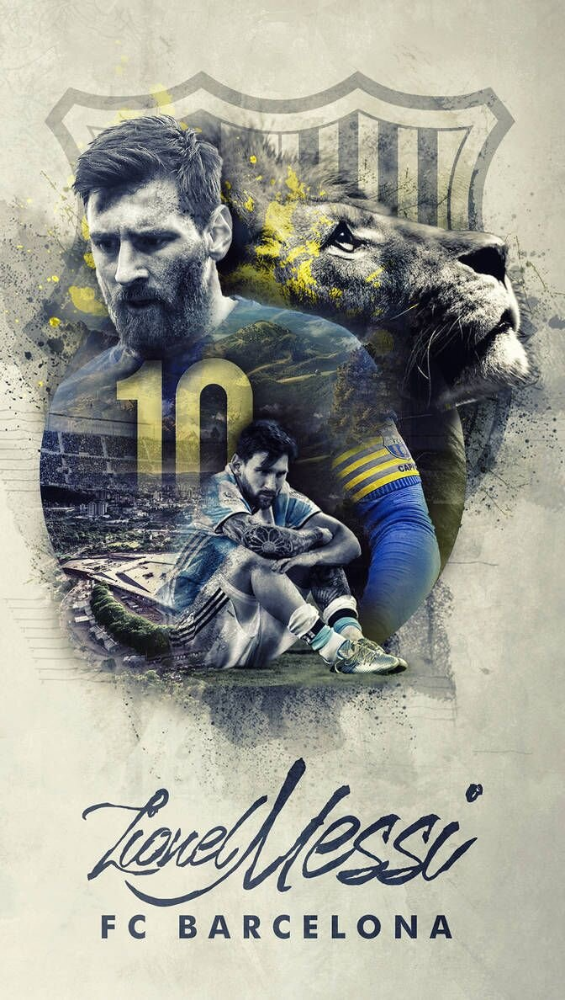

(1188, 672, 3)


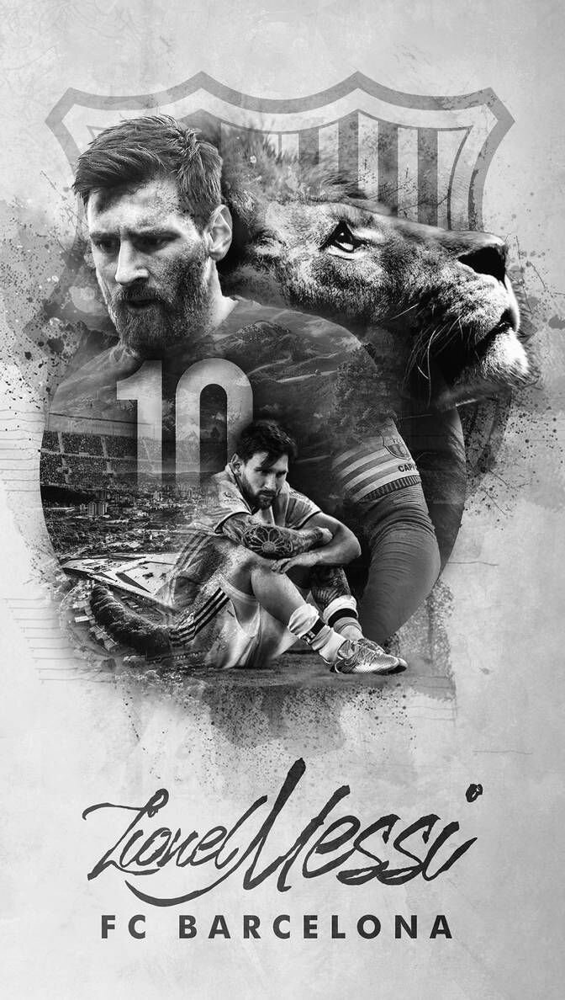

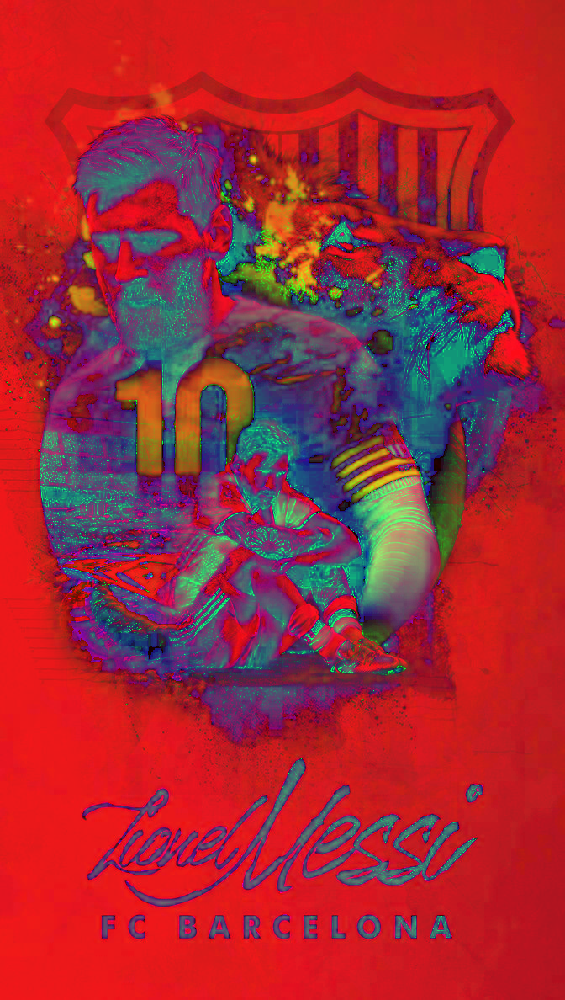

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("images/messi1.jpg")
cv2_imshow(img)
print(img.shape)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
cv2_imshow(hsv)

# EDGE DETECTION 


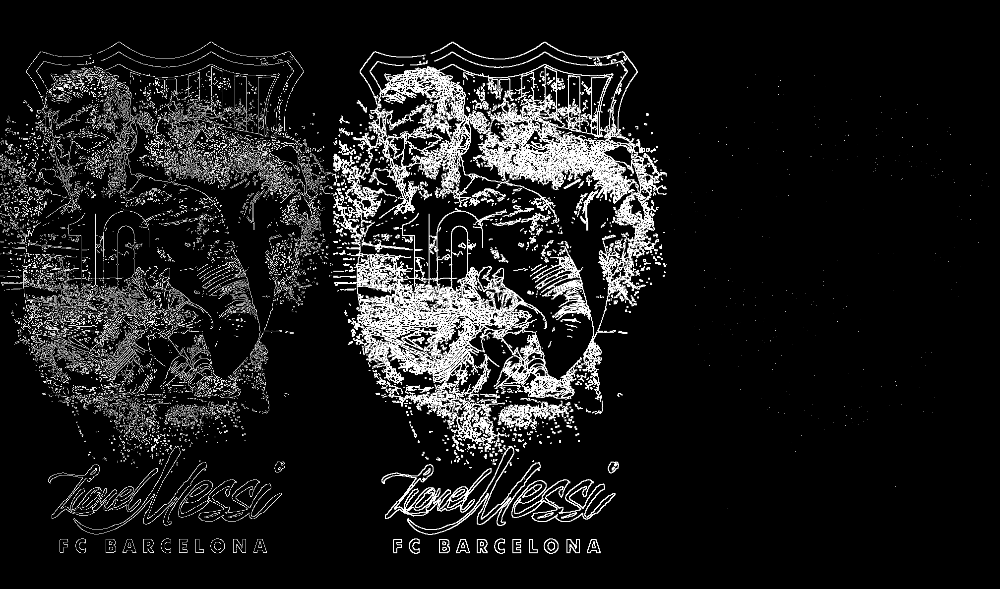

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("images/messi1.jpg")
# cv2_imshow(img)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

canny_img = cv2.Canny(gray, 150, 200)
# cv2_imshow(canny_img)

##These techniques are used for lane detection

#Erosion of image
kernel = np.ones((2,2),np.uint8)
erode_img = cv2.erode(canny_img, kernel, iterations=1)
# cv2_imshow(erode_img)

#Dilation of image
# kernel = np.ones((2,2),np.uint8)
dilate_img = cv2.dilate(canny_img, kernel, iterations=1)
# cv2_imshow(dilate_img)

#Horizontal stack 
display = np.hstack((canny_img, dilate_img, erode_img))
cv2_imshow(display)

# IMAGE MANIPULATION


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

!git clone https://github.com/misbah4064/opencvTutorial.git
%cd opencvTutorial/
from IPython.display import clear_output
clear_output()

# img = cv2.imread("images/lion.jpg")
# # cv2_imshow(img)

# ##Denoising the picture profile

# dst = cv2.fastNlMeansDenoisingColored(img, None, 20, 20, 7, 15)
# display = np.hstack((img, dst))
# cv2_imshow(display)

# DRAWING SHAPES AND WRITING TEXT ON IMAGES

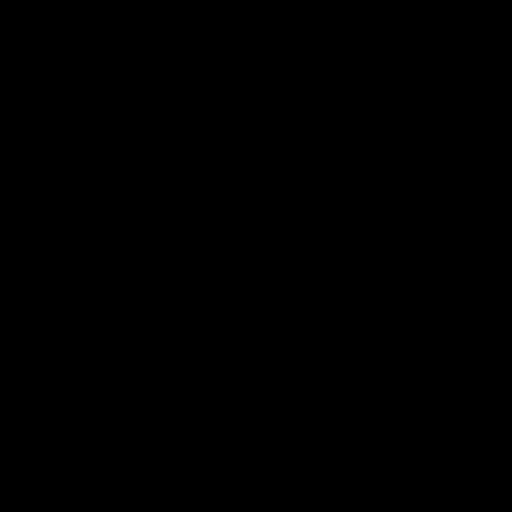

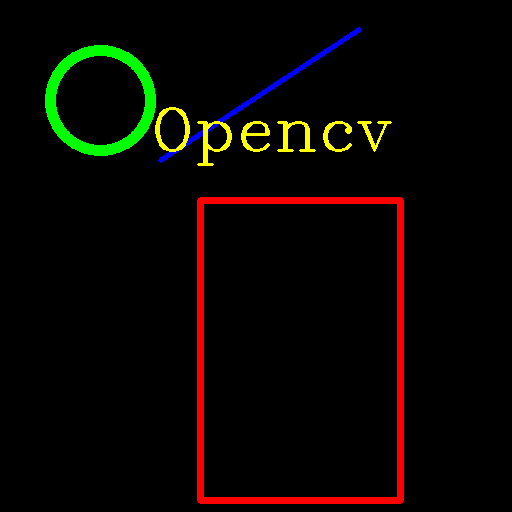

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = np.zeros((512,512,3),np.uint8)        #creates a matrix of zeros(black colour)  , used unsinged integer of byte size 8 as it contains values 0 to 255                 
cv2_imshow(img)

#Drawing functions
#Draw a circle
cv2.circle(img, (100,100), 50, (0, 255, 0), 10)

#Draw a rectangle
cv2.rectangle(img, (200,200), (400,500),(0,0,255),5)

#Draw a line
cv2.line(img, (160,160), (359,29), (255,0,0), 3)

#Write a text
cv2.putText(img, "Opencv", (150,150), cv2.FONT_HERSHEY_COMPLEX, 2, (0,255,255),2)
cv2_imshow(img)

# COLOR DETECTION

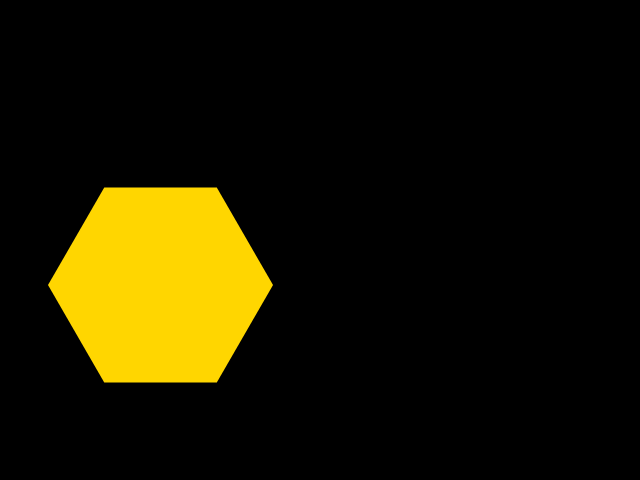

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("images/shapes.png")
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

#Blue colour triangle
lower_blue = np.array([65,0,0])
upper_blue  = np.array([110,255,255])

#Red colour
lower_red = np.array([0,0,0])
upper_red = np.array([20,255,255])

#Green colour
lower_green = np.array([45,0,0])
upper_green = np.array([91,255,255])

#Yellow Colour
lower_yellow = np.array([21,0,0])
upper_yellow = np.array([45,255,255])

mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
#cv2_imshow(mask)

result = cv2.bitwise_and(img, img, mask=mask)
cv2_imshow(result)

# cv2_imshow(hsv)
#cv2_imshow(img)

# FACE DETECTION

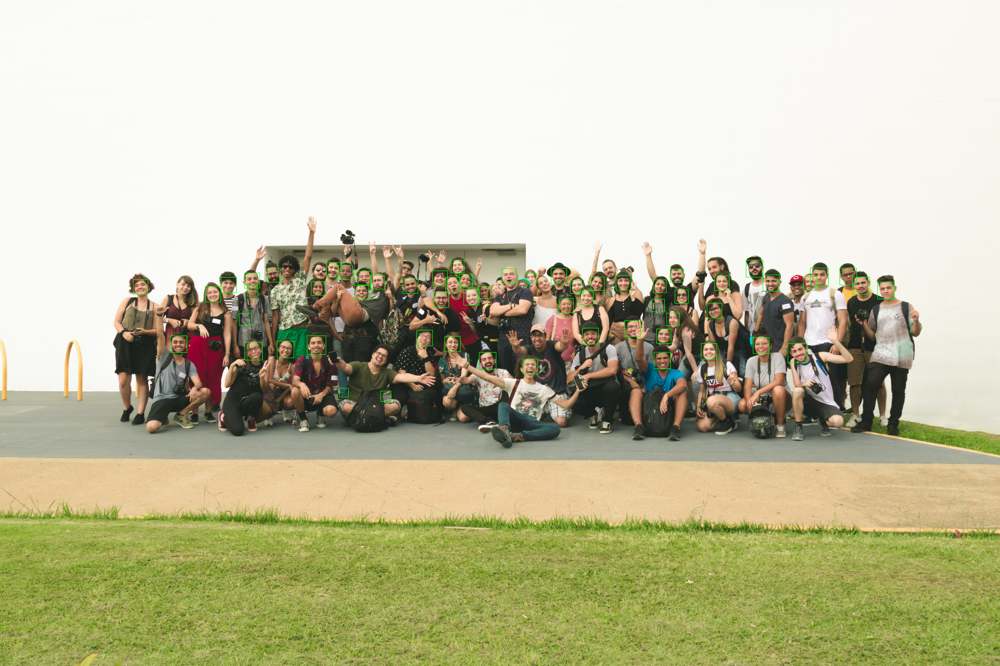

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier("files/haarcascade_frontalface_default.xml")
img = cv2.imread("images/group.jpg")

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray,1.3,5)

for (x,y,w,h) in faces:
  cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
cv2_imshow(img)

# SHAPE DETECTION

This is a square
This is a Hexagon
This is a triangle
This is a circle
This is a square


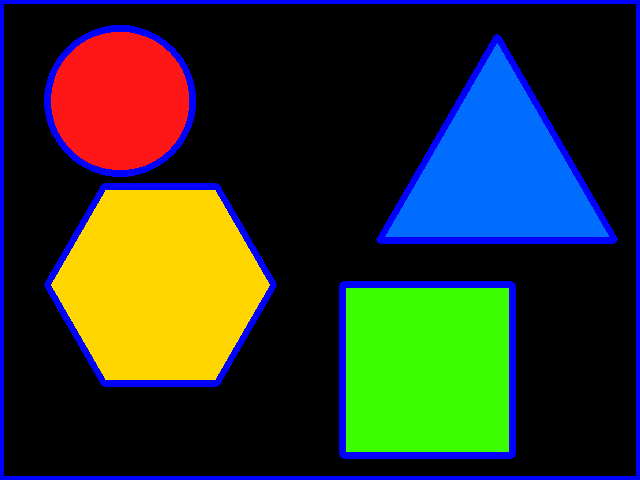

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("images/shapes.png")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

ret, thresh = cv2.threshold(gray,50,255,1)
contours,h = cv2.findContours(thresh,1,2)

for cnt in contours:
  approx = cv2.approxPolyDP(cnt, 0.01*cv2.arcLength(cnt,True),True)
  n = len(approx)
  if n==6:
    #this is a hexagon
    print("This is a Hexagon")
    cv2.drawContours(img,[cnt],0,255,5)

  elif n==4:
    #this is a square
    print("This is a square")
    cv2.drawContours(img,[cnt],0,255,5)

  elif n==3:
    #this is a trinagle
    print("This is a triangle")
    cv2.drawContours(img,[cnt],0,255,5)

  elif n>9:
    #this is a circle
    print("This is a circle")
    cv2.drawContours(img,[cnt],0,255,5)


# cv2_imshow(thresh)
cv2_imshow(img)

# PROJECT ONE : TRACKING A BALL

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

ball=[]
cap = cv2.VideoCapture("videos/video.mp4")
out = cv2.VideoWriter('output.avi', cv2.VideoWriter.fourcc( 'M', 'J', 'P', 'G'), 10, (1920,1080))

while cap.isOpened():
  ret, frame = cap.read()
  if ret is False:
    break
  hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
  lower_yellow = np.array([21,0,0])
  upper_yellow = np.array([45,255,255])
  mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
  (contours,_) = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
  center = None;

  if len(contours)>0:
    c = max(contours, key=cv2.contourArea)
    ((x,y), radius) = cv2.minEnclosingCircle(c)
    m = cv2.moments(c)
    try:
      center = (int(m["m10"]/m["m00"]),int(m["m01"]/m["m00"]))
      cv2.circle(frame, center, 10, (255,0,0), -1)
      ball.append(center)
    except:
      pass

  if len(ball)>2:
    for i in range(1, len(ball)):
      cv2.line(frame, ball[i-1], ball[i], (0,0,255), 5)

  out.write(frame)
out.release()



# PROJECT TWO : FACE RECOGNITION

In [ ]:
!git clone https://github.com/misbah4064/face_recognition.git
!pip install face_recognition
%cd face_recognition

Cloning into 'face_recognition'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 26 (delta 5), reused 23 (delta 3), pack-reused 0
Unpacking objects: 100% (26/26), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 100.1 MB 1.2 MB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566185 sha256=7c54f5cf71dabc4c4edf61a59dfb3d90d01a356bba7aa7cb4e017a8b9b379336
  Stored in directory: /root/.cache/pip/wheels/b4/4b/8f/751e99d45f089bdf366a7d3e5066db3c2b84a62e4377f534d7
Successfully built face-recognition-models
/content/face_recognition


# Create Encoding Profile using known faces

In [ ]:
import face_recognition
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

#Creating encoding profiles 
face_1 = face_recognition.load_image_file("elon.jpg")
face_1_encoding = face_recognition.face_encodings(face_1)[0]

face_2 = face_recognition.load_image_file("Donald Trump.jpg")
face_2_encoding = face_recognition.face_encodings(face_2)[0]

face_3 = face_recognition.load_image_file("jeffbezos.jpg")
face_3_encoding = face_recognition.face_encodings(face_3)[0]

known_face_encodings = [face_1_encoding,face_2_encoding,face_3_encoding]
known_face_names = ["Elon Musk", "Donald Trump", "Jeff Bezos"]


# Create Encoding Profile using unknown faces

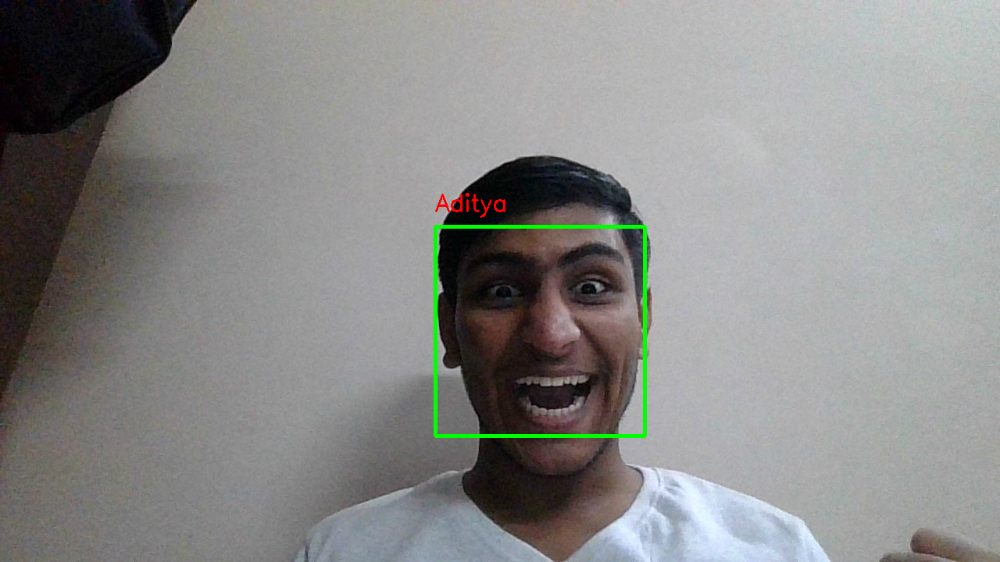

In [ ]:
import face_recognition
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

face_1 = face_recognition.load_image_file("aditya3.jpg")
face_1_encoding = face_recognition.face_encodings(face_1)[0]

face_2 = face_recognition.load_image_file("Donald Trump.jpg")
face_2_encoding = face_recognition.face_encodings(face_2)[0]

face_3 = face_recognition.load_image_file("jeffbezos.jpg")
face_3_encoding = face_recognition.face_encodings(face_3)[0]

known_face_encodings = [face_1_encoding,face_2_encoding,face_3_encoding]
known_face_names = ["Aditya", "Donald Trump", "Jeff Bezos"]

file_name = "aditya2.jpg"
unknown_image = face_recognition.load_image_file(file_name)
unknown_image_to_draw = cv2.imread(file_name)

face_locations = face_recognition.face_locations(unknown_image)
face_encoding = face_recognition.face_encodings(unknown_image, face_locations)

for (top, right, bottom, left), face_encoding in zip(face_locations, face_encoding):
  matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

  name = "Unknown"

  face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
  best_match_index =np.argmin(face_distances)

  if matches[best_match_index]:
    name = known_face_names[best_match_index]
    cv2.rectangle(unknown_image_to_draw, (left, top), (right, bottom), (0,255,0), 3)
    cv2.putText(unknown_image_to_draw,name, (left, top-20), cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255), 2)

cv2_imshow(unknown_image_to_draw)
